In [1]:
#import libraries
import pandas as pd
import numpy as np
import csv
import ast
import re
from prettytable import PrettyTable

from collections import Counter

import time
import random
import glob

#data visualization libraries
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, ImageColorGenerator

#NLP & ML libraries
from gensim.models import Word2Vec
from gensim.utils import tokenize
from gensim.models.phrases import Phrases
from textblob import TextBlob
from nltk import FreqDist

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_samples, silhouette_score

from sklearn.metrics.pairwise import cosine_similarity

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance

from scipy.sparse import save_npz, load_npz

In [2]:
#set seed so that code output is deterministic
random.seed(40)  # Set the seed for Python's random module
np.random.seed(40)  # Set the seed for NumPy's random module

In [35]:
#import filtered data

def list_converter(text):
    #to revert list->str conversion from pd.read_csv
    return ast.literal_eval(text)


data = pd.read_csv('Data/filtered_corpus.csv', converters ={'tokens':list_converter,
                                                           'updated_tokens': list_converter})

In [36]:
data = data.drop(columns = ['index'])
print (data.shape)
data.head()

(96015, 8)


,text_type,ID,year,long_text,clean_text,word_count,tokens,updated_tokens
0,comment,gtfo2hl,2021,"*Cuntry roads, take me hoem*",cuntry roads hoem,3,"[cuntry, road, hoem]",[road]
1,comment,gtfou07,2021,I am single and I have not traveled to any cun...,single traveled cuntry past year,5,"[single, travel, cuntry, past, year]","[single, travel, past]"
2,comment,gtfrgpe,2021,What happens when you shop at dragon mart...,happens shop dragon mart,4,"[happen, shop, dragon, mart]","[shop, dragon, mart]"
3,comment,gthiiwi,2021,"That’s just absolutely hilarious, is this in t...",absolutely hilarious springs souk,4,"[absolutely, hilarious, spring, souk]","[hilarious, spring, souk]"
4,comment,gtfw6yj,2021,Eugene's first day as a signwriter for Country...,eugene s day signwriter country artificial pro...,8,"[eugene, s, day, signwriter, country, artifici...","[artificial, product]"


In [37]:
# Count the number of rows where the length of 'tokens' is less than 3
count = data[data['updated_tokens'].apply(lambda x: len(x) < 5)].shape[0]
indx = data[data['updated_tokens'].apply(lambda x: len(x) < 5)].index
print(f"Number of rows with less than 3 tokens: {count}")
print (indx[:5])

Number of rows with less than 3 tokens: 46213
Index([0, 1, 2, 3, 4], dtype='int64')


In [38]:
data = data.drop(indx, axis = 0)
data

,text_type,ID,year,long_text,clean_text,word_count,tokens,updated_tokens
19,comment,gtgbdm3,2021,When I first saw it that’s actually how I read...,saw actually read wondered poor plant labelled...,8,"[saw, actually, read, wonder, poor, plant, lab...","[saw, read, poor, plant, label]"
21,comment,gth2mea,2021,It’s a simple “joke” but I couldn’t resist. In...,simple joke resist case mildly amusing misspel...,19,"[simple, joke, resist, case, mildly, amusing, ...","[simple, joke, resist, case, mildly, amusing, ..."
22,comment,gth8nay,2021,"The first 4 letters are a swear word, many wou...",letters swear word consider swear word use vul...,20,"[letter, swear, word, consider, swear, word, u...","[letter, swear, swear, correct, style, decor, ..."
28,comment,gpmqnne,2021,Unfortunately this is the same world wide. I r...,unfortunately world wide remember graduated la...,18,"[unfortunately, world, wide, remember, graduat...","[unfortunately, wide, graduate, land, field, l..."
29,comment,gpmnu0u,2021,even an entry level job needed 3 to 5 years ex...,entry level job needed years experience senior...,11,"[entry, level, job, need, year, experience, se...","[entry, level, experience, senior, certificati..."
...,...,...,...,...,...,...,...,...
96009,submission,14f49ta,2023,Legal advice needed. Would highly appreciate i...,legal advice needed highly appreciate legal ad...,21,"[legal, advice, need, highly, appreciate, lega...","[legal, advice, highly, legal, advice, highly,..."
96010,submission,14f46ji,2023,"Best beauty saloons in Dubai? Hello fellas, I ...",best beauty saloons dubai hello fellas moved w...,35,"[good, beauty, saloon, dubai, hello, fellas, m...","[beauty, saloon, hello, wife, real, saloon, re..."
96012,submission,14f4ri3,2023,Scam ? Healthy.line My sister has a CBD debit ...,scam healthy line sister cbd debit card month ...,47,"[scam, healthy, line, sister, cbd, debit, card...","[scam, healthy, line, sister, cbd, debit, card..."
96013,submission,14f4k3r,2023,Thoughts on Expo City properties? Anyone else ...,thoughts expo city properties checked expo cit...,21,"[thought, expo, city, property, check, expo, c...","[expo, property, expo, sale, page, pleasant, d..."


## **IMPORT WORD2VEC MODELS**

In [39]:
#import word2vec models
models = glob.glob('pretrained_models/*')

models

['pretrained_models/filtered_corpus_model.model',
 'pretrained_models/full_corpus_model.model',
 'pretrained_models/bigram_full_corpus_model.model.wv.vectors.npy',
 'pretrained_models/bigram_filtered_corpus_model.model',
 'pretrained_models/glove-wiki_gigaword-100',
 'pretrained_models/bigram_full_corpus_model.model',
 'pretrained_models/bigram_full_corpus_model.model.syn1neg.npy',
 'pretrained_models/glove-wiki_gigaword-100.vectors.npy']

In [42]:
#filtered corpus model

fc_model =Word2Vec.load(models[1])

#check number of unique words
num_unique_words = len(fc_model.wv.index_to_key)
print(f"Number of unique words in the vocabulary: {num_unique_words}")

#confirm model by checking for 'reddit' which was filtered out of corpus before model training
print(fc_model.wv.most_similar('reddit'))

Number of unique words in the vocabulary: 21945
[('sub', 0.8964521288871765), ('subreddit', 0.8800749182701111), ('mod', 0.8635022640228271), ('thread', 0.82708740234375), ('delete', 0.8173986673355103), ('moderator', 0.801443338394165), ('bash', 0.8013561964035034), ('discussion', 0.799430787563324), ('post', 0.7976388335227966), ('forum', 0.7918344736099243)]


In [43]:
#check model performance
fc_model.wv.most_similar('hypermarket')

[('nesto', 0.9796707034111023),
 ('spinney', 0.9700532555580139),
 ('wholesaler', 0.9670606851577759),
 ('mcdonalds', 0.9577053189277649),
 ('discovery', 0.9541906118392944),
 ('westzone', 0.9519684314727783),
 ('turkish', 0.950433611869812),
 ('dip', 0.9503304362297058),
 ('waitrose', 0.9478459358215332),
 ('spinneys', 0.9463972449302673)]

In [44]:
fc_model.wv.similarity('rta', 'nol')

0.6894194

In [45]:
fc_model.wv.similarity('rta', 'metro')

0.5692062

In [46]:
fc_model.wv.similarity('rta', 'bus')

0.70310414

In [47]:
fc_model.wv.similarity('jlt', 'deira')

0.94326854

## **CREATE DOCUMENT VECTORS**

In [48]:
#create document vectors using average of word vectors

#code from Dylan Castillo https://dylancastillo.co/nlp-snippets-cluster-documents-using-word2vec/#train-word2vec-model

def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features

In [49]:
fc_vectorized_docs = vectorize(data['updated_tokens'].values, model=fc_model)
len(fc_vectorized_docs), len(fc_vectorized_docs[0])

(49802, 100)

In [50]:
#maybe normalize the document vectors?

from sklearn.preprocessing import Normalizer

normalizer = Normalizer()
normalized_fc_doc_vectors = normalizer.fit_transform(fc_vectorized_docs)

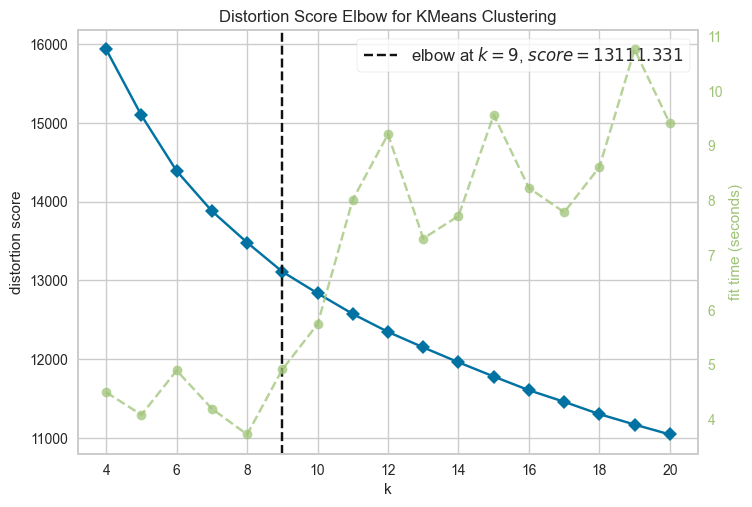

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [51]:
#determine optimum k-clusters using yellowbrick visualizer

kmeans = KMeans(init = 'k-means++', n_init = 10, max_iter = 300, random_state = 0)
visualizer = KElbowVisualizer(kmeans, k = (4,21))

visualizer.fit(np.array(normalized_fc_doc_vectors))
visualizer.show()

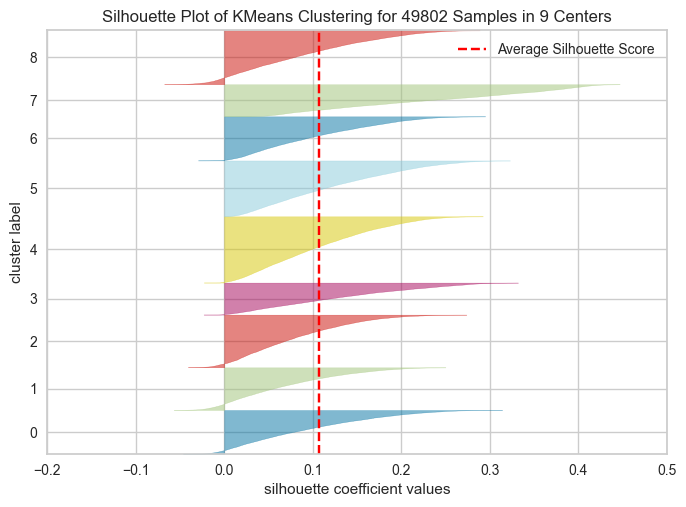

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 49802 Samples in 9 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [52]:
sil_visualizer = SilhouetteVisualizer(
                    KMeans(n_clusters=visualizer.elbow_value_, 
                           init="k-means++", max_iter=300, n_init=10, random_state = 12), 
                    colors = 'yellowbrick')

sil_visualizer.fit (np.array(normalized_fc_doc_vectors))
sil_visualizer.show()

In [53]:
#document clustering with optimal k value from visualizer
true_k = visualizer.elbow_value_

kmeans = KMeans(n_clusters=true_k, init="k-means++", max_iter=300, n_init=10, random_state = 12)

kmeans.fit(np.array(normalized_fc_doc_vectors))

KMeans(n_clusters=9, n_init=10, random_state=12)

In [54]:
#print out top 10 words occurring in documents in each cluster

# Assign each document to a cluster
clusters = kmeans.labels_

# For each cluster
for i in range(true_k):
    print(f"Cluster {i}:")

    # Find all the documents that belong to this cluster
    docs_in_cluster = [doc for doc, cluster in zip(data['updated_tokens'].values, clusters) if cluster == i]

    # Count the frequency of each word in these documents
    word_freq = Counter(word for doc in docs_in_cluster for word in doc)

    # Print the 10 words with the highest frequency
    for word, freq in word_freq.most_common(10):
        print(f"    {word}")


Cluster 0:
    card
    bank
    call
    service
    credit
    website
    etisalat
    email
    contact
    customer
Cluster 1:
    case
    police
    test
    report
    fine
    covid
    take
    mask
    law
    vaccine
Cluster 2:
    movie
    parent
    take
    read
    call
    family
    stop
    child
    learn
    experience
Cluster 3:
    food
    water
    restaurant
    eat
    order
    chicken
    drink
    taste
    burger
    delivery
Cluster 4:
    salary
    visa
    business
    experience
    family
    low
    offer
    passport
    market
    government
Cluster 5:
    culture
    arab
    muslim
    arabic
    indian
    language
    racism
    english
    local
    law
Cluster 6:
    price
    buy
    cost
    sell
    rent
    cheap
    service
    charge
    property
    delivery
Cluster 7:
    lane
    drive
    road
    speed
    driver
    fast
    fine
    traffic
    limit
    slow
Cluster 8:
    area
    mall
    walk
    building
    park
    beac

In [55]:
#number of documents per cluster
cluster_df = data.copy()
cluster_df['labels'] = clusters

doc_per_cluster = cluster_df.groupby('labels').size()

doc_per_cluster

labels
0    5140
1    5019
2    6199
3    3766
4    7800
5    6572
6    5189
7    3768
8    6349
dtype: int64

In [56]:
# Reduce the dimensionality of the document vectors to 2D
import plotly.express as px

pca = PCA(n_components=2)
doc_vectors_2d = pca.fit_transform(normalized_fc_doc_vectors)
docs = data['updated_tokens'].copy()

In [ ]:
from sklearn.manifold import TSNE

# Apply t-SNE to reduce dimensionality to 2D
tsne = TSNE(n_components=2, learning_rate = 50)
doc_vectors_2d = tsne.fit_transform(normalized_fc_doc_vectors)

In [57]:
doc_vectors_2d[1][1]

-0.18693814

In [58]:
print(len(doc_vectors_2d))
print(len(clusters))
print(len(docs))


49802
49802
49802


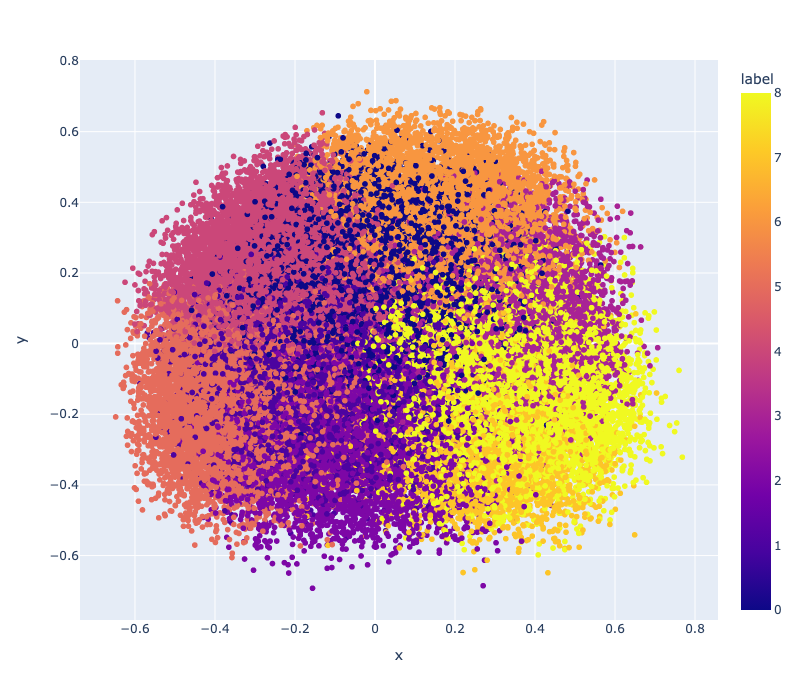

In [59]:
# Create a DataFrame with the 2D vectors and the labels
df = pd.DataFrame({
                'x':doc_vectors_2d[:, 0],
                'y':doc_vectors_2d[:, 1],
                'label': clusters,
                'docs': docs})


# Create the scatter plot
fig = px.scatter(df, x='x', y='y', 
                 color='label',
                 hover_data = ['docs']
                )
fig.update_layout(width = 800, height = 700)
fig.show()


### word clustering --- disregard

In [ ]:
#determine optimum k-clusters using yellowbrick visualizer

fc_vectors= fc_model.wv.vectors #2d word vectors for clustering


kmeans = KMeans(init = 'k-means++', n_init = 10, max_iter = 300, random_state = 0)
visualizer = KElbowVisualizer(kmeans, k = (1,21))

visualizer.fit(fc_vectors)
visualizer.show()


In [ ]:
optimal_k = visualizer.elbow_value_

# Kmeans clustering
kmeans = KMeans(n_clusters=optimal_k, init='k-means++', n_init=10, random_state=0)
kmeans.fit(fc_vectors)

# cluster label for each word
labels = kmeans.labels_

# map word to cluster label
word_to_cluster = {word: cluster for word, cluster in zip(fc_model.wv.index_to_key, labels)}

# print 10 words in each cluster
for i in range(optimal_k):
    words_in_cluster = [word for word, cluster in word_to_cluster.items() if cluster == i]
    print(f"Cluster {i}: {words_in_cluster[:10]}")

In [ ]:
# Reduce the dimensionality of the document vectors to 2D
import plotly.express as px

pca = PCA(n_components=2)
word_vectors_2d = pca.fit_transform(fc_vectors)
words = fc_model.wv.index_to_key

In [ ]:
# Create a DataFrame with the 2D vectors and the labels
df = pd.DataFrame({
                'x':word_vectors_2d[:, 0],
                'y':word_vectors_2d[:, 1],
                'label': labels,
                'word': words})


# Create the scatter plot
fig = px.scatter(df, x='x', y='y', 
                 color='label',
                 hover_data = ['word']
                )
fig.update_layout(width = 800, height = 700)
fig.show()


In [ ]:
#number of documents per cluster
cluster_df = data.copy()
cluster_df['labels'] = clusters

doc_per_cluster = cluster_df.groupby('labels').size()

doc_per_cluster

In [ ]:
mask = cluster_df['labels'] == 7
cluster_df[mask].sample(n=5)